In [96]:
import os

os.environ["KERAS_BACKEND"] = "tensorflow"

import numpy as np
import tensorflow as tf
import keras

# Display
from IPython.display import Image, display
import matplotlib as mpl
import matplotlib.pyplot as plt
from tqdm import tqdm  # Import tqdm for progress display
from tensorflow.keras.models import load_model
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions

In [4]:
def get_img_array(img_path, size):
    # `img` is a PIL image of size 299x299
    img = keras.utils.load_img(img_path, target_size=size)
    # `array` is a float32 Numpy array of shape (299, 299, 3)
    array = keras.utils.img_to_array(img)
    # We add a dimension to transform our array into a "batch"
    # of size (1, 299, 299, 3)
    array = np.expand_dims(array, axis=0)
    return array


def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = keras.models.Model(
        model.inputs, [model.get_layer(last_conv_layer_name).output, model.output]
    )
   

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
            
        class_channel = preds[:, pred_index]
        #print(last_conv_layer_output)

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)
    print(grads)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [103]:
import pandas as pd
df=pd.read_csv("/home/trl102/Dir/MyDailyWork/Radimax/all_df_2018_june_13c.csv").drop('Unnamed: 0',axis=1)
# Assuming your DataFrame is named df
# Assuming your DataFrame is named df
df=pd.read_csv("Data_May_June_2019.csv").drop('Unnamed: 0',axis=1)
#df.rename(columns={'Delta13C': 'Isotope'}, inplace=True)

print(df.shape)
df['soil_depth']= (((df['tube_depth']-420)*np.sin((23.5*(np.pi/180)))+570))/10.0 # in cm
#df=df[(df['soil_depth']>140) & (df['soil_depth']<190)]
df.dropna(inplace=True)
print(df.shape)
df['target'] = df['pRLD'].apply(lambda x: 0 if x < 0.001 else 1)

FileNotFoundError: [Errno 2] No such file or directory: 'Data_May_June_2019.csv'

In [ ]:
df

In [104]:
index_for_tube_depth_2430 = df.loc[(df['tube_depth'] == 2992) & (df['tube'] == 171)].index

index=index_for_tube_depth_2430[0]
index

144

In [102]:
df.iloc[index][0]

'/home/trl102/Dir/FullDataJune2018/Wheat4/Radimax_Cam1_PipeID_171_Position_2992_TS_2018-06-19 09.14.38.994B.jpg'

tf.Tensor(
[[[[-1.1770980e-04  1.3593586e-04  8.9554396e-04 ...  1.5782905e-06
    -3.3660582e-03  1.2287361e-04]
   [-1.1770980e-04  1.3593586e-04  8.9554396e-04 ...  1.5782905e-06
    -3.3660582e-03  1.2287361e-04]
   [-1.1770980e-04  1.3593586e-04  8.9554396e-04 ...  1.5782905e-06
    -3.3660582e-03  1.2287361e-04]
   ...
   [-1.1770980e-04  1.3593586e-04  8.9554396e-04 ...  1.5782905e-06
    -3.3660582e-03  1.2287361e-04]
   [-1.1770980e-04  1.3593586e-04  8.9554396e-04 ...  1.5782905e-06
    -3.3660582e-03  1.2287361e-04]
   [-1.1770980e-04  1.3593586e-04  8.9554396e-04 ...  1.5782905e-06
    -3.3660582e-03  1.2287361e-04]]

  [[-1.1770980e-04  1.3593586e-04  8.9554396e-04 ...  1.5782905e-06
    -3.3660582e-03  1.2287361e-04]
   [-1.1770980e-04  1.3593586e-04  8.9554396e-04 ...  1.5782905e-06
    -3.3660582e-03  1.2287361e-04]
   [-1.1770980e-04  1.3593586e-04  8.9554396e-04 ...  1.5782905e-06
    -3.3660582e-03  1.2287361e-04]
   ...
   [-1.1770980e-04  1.3593586e-04  8.9554396e-

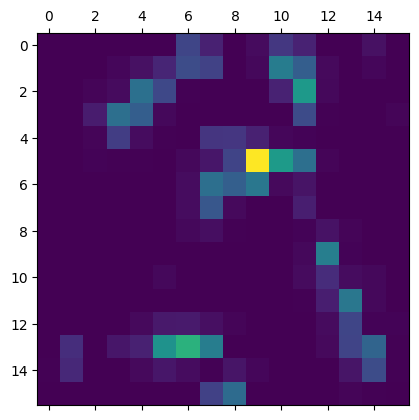

In [86]:
# Prepare image
# Load your trained model
#model = load_model('/home/trl102/Dir/best_model_weights_classification_2018_13C_Classify.h5')
# Load your trained model
model = load_model('/home/trl102/Dir/MyDailyWork/DL2019/best_model_weights_classification_2019_T_run2.h5')
# Define last convolutional layer name

# Define last convolutional layer name
last_conv_layer_name = 'conv5_block3_out'
img_size = (500, 500,3)

#index=90
img_path = df.iloc[index][0]
img_array = get_img_array(img_path, size=img_size)

# Make model

# Remove last layer's softmax


model.layers[-1].activation = None

#model.layers[-2].activation = None

# Print what the top predicted class is
#preds = model.predict(img_array)
#print("Predicted:", decode_predictions(preds, top=1)[0])
last_conv_layer_name = 'conv5_block3_out'

# Generate class activation heatmap
heatmap = make_gradcam_heatmap(img_array /255, model, last_conv_layer_name)

# Display heatmap
plt.matshow(heatmap)
    
plt.show()

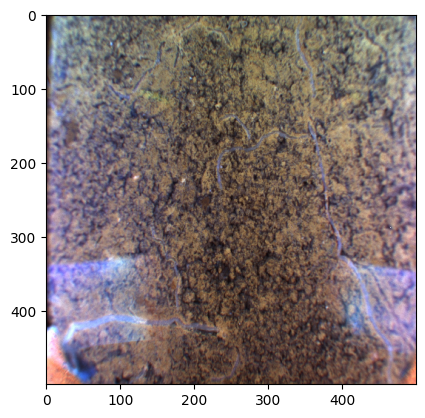

In [87]:

# Assuming img_array is the normalized image array
# If img_array is already in the range [0, 1], you can skip this step
img_array_display = img_array[0]

plt.imshow(img_array_display.astype('uint8'))
plt.show()

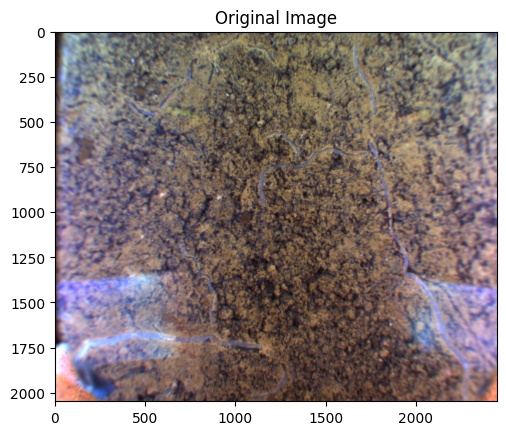

In [88]:

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Load the original image
img_path = df.iloc[index][0]
img = mpimg.imread(img_path)

# Display the original image
plt.imshow(img)
plt.title('Original Image')
#plt.axis('off')  # Optional: Turn off axis labels
plt.show()

In [89]:
img_array_display.shape

(500, 500, 3)

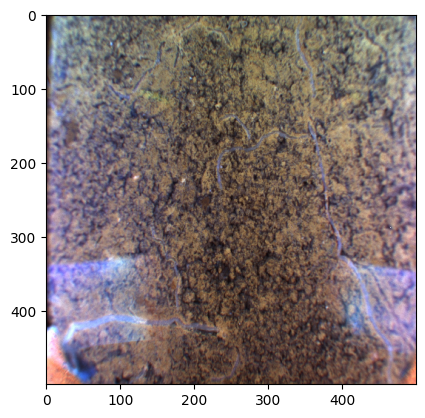

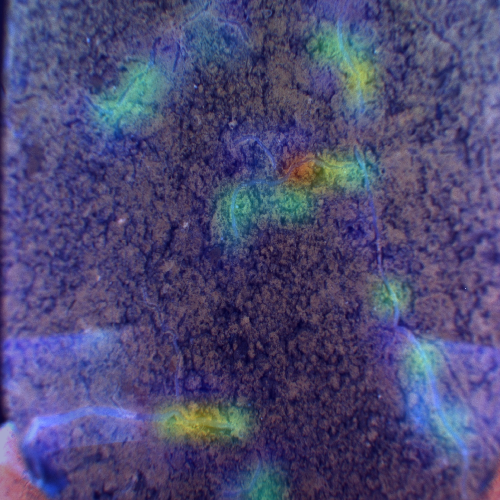

In [90]:
import numpy as np
import keras
from keras.preprocessing import image
from PIL import Image  # Import the Image module from PIL

def save_and_display_gradcam(img, heatmap, cam_path="cam1.jpg", alpha=0.5):
    # Load the original image
   # img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)
   


  # Convert the image back to array


    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = mpl.colormaps["jet"]

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)

    # Superimpose the heatmap on the original image
    superimposed_img = jet_heatmap * alpha + img
    
    superimposed_img = keras.utils.array_to_img(superimposed_img)

    # Save the superimposed image
    superimposed_img.save(cam_path)

    # Display Grad CAM using IPython.display
   # ipython_display(ipython_Image(cam_path))
    return superimposed_img

# Example usage

# Assuming img_array is the normalized image array
# If img_array is already in the range [0, 1], you can skip this step
img_array_display = img_array[0]

plt.imshow(img_array_display.astype('uint8'))
plt.show()
img=img_array_display

superimposed_img=save_and_display_gradcam(img, heatmap)
superimposed_img



In [95]:
img_array_display = img_array[0]
img_array_display.shape

(2048, 2048, 3)

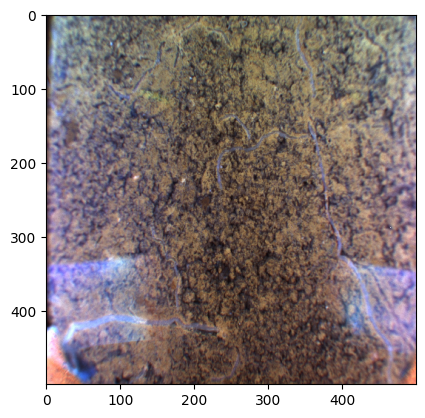

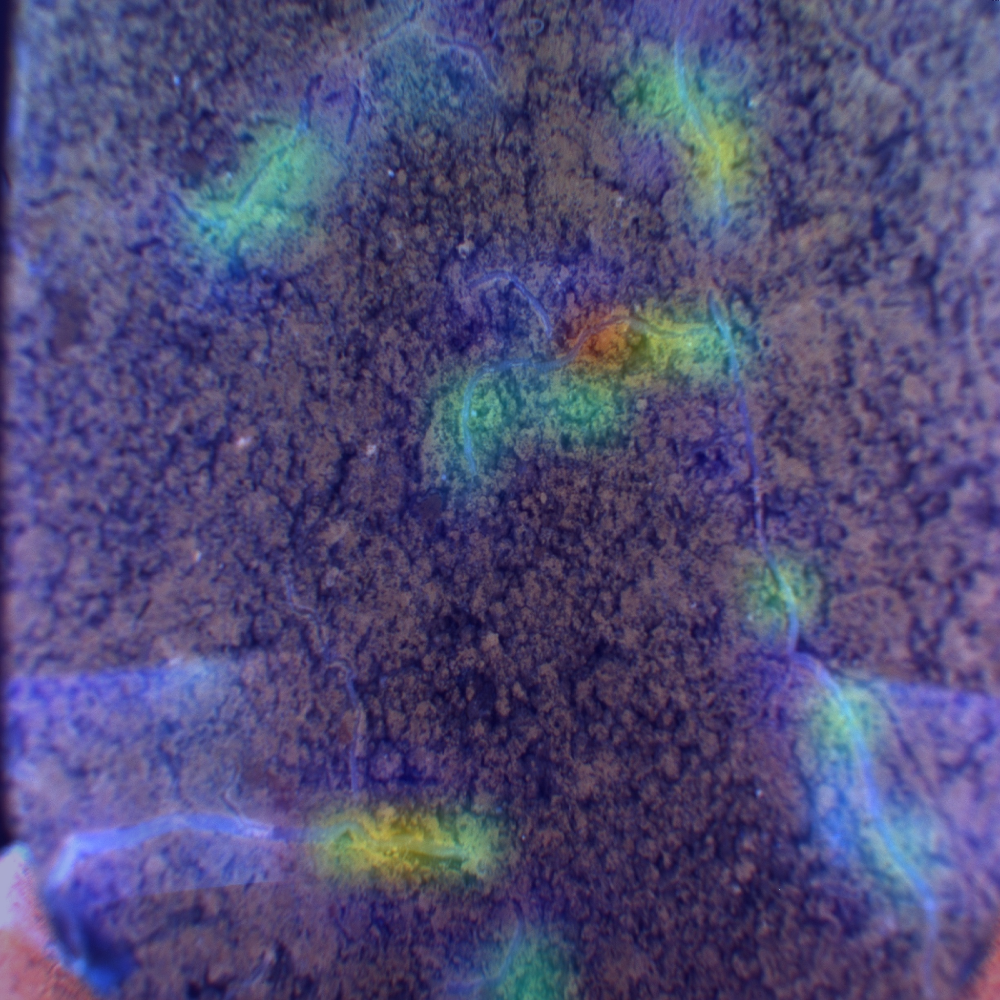

In [92]:
import numpy as np
import keras
from keras.preprocessing import image
from PIL import Image  # Import the Image module from PIL

def save_and_display_gradcam(img, heatmap, cam_path="cam1.jpg", alpha=0.5):
    # Load the original image
   # img = keras.utils.load_img(img_path)
    img = keras.utils.img_to_array(img)
   


  # Convert the image back to array


    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = mpl.colormaps["jet"]

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.utils.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.utils.img_to_array(jet_heatmap)

    # Superimpose the heatmap on the original image
    superimposed_img = jet_heatmap * alpha + img
    
    superimposed_img = keras.utils.array_to_img(superimposed_img)

    # Save the superimposed image
    superimposed_img.save(cam_path)

    # Display Grad CAM using IPython.display
   # ipython_display(ipython_Image(cam_path))
    return superimposed_img

# Example usage

# Assuming img_array is the normalized image array
# If img_array is already in the range [0, 1], you can skip this step
img_array_display = img_array[0]

plt.imshow(img_array_display.astype('uint8'))
plt.show()


img_path = df.iloc[index][0]
img_array = get_img_array(img_path, size=(2048,2048,3))
img=img_array

#img=img_array_display #for 500x500

superimposed_img=save_and_display_gradcam(img[0], heatmap)

superimposed_img

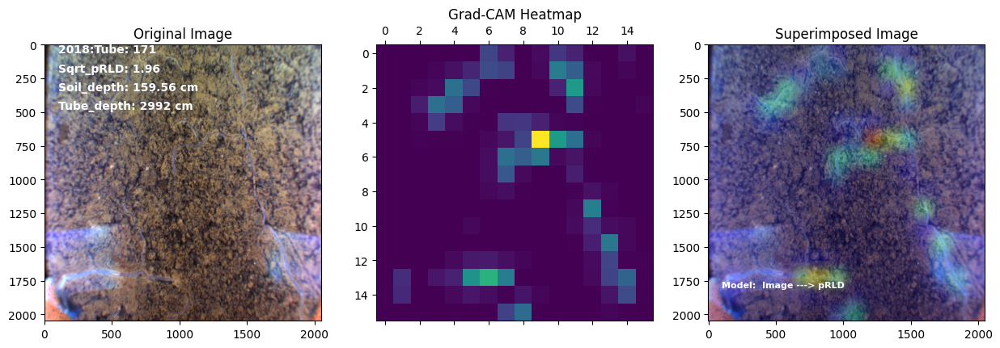

In [82]:
import cv2
import matplotlib.pyplot as plt
from IPython.display import Image as ipython_Image, display
from IPython.display import display as ipython_display, Image as ipython_Image

# Assuming img_array is the normalized image array
# If img_array is already in the range [0, 1], you can skip this step
img_array_display = img_array[0]
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Subplot 1: Original Image
axs[0].imshow(img_array_display.astype('uint8'))
axs[0].set_title('Original Image')
# Add text labels
#id	Isotope	pRLD	tube_depth	tube	soil_depth	

text_label = f'2018:Tube: {df.iloc[index][4]}'
text_label1 = f'Sqrt_pRLD: {df.iloc[index][2]:.2f}'
text_label2 = f'Soil_depth: {df.iloc[index][5]:.2f} cm'
text_label3 = f'Tube_depth: {df.iloc[index][3]} cm'
text_model=f'Model:  Image ---> pRLD'
axs[0].text(100, 60, text_label, color='white', fontsize=10, fontweight='bold')
axs[0].text(100, 200, text_label1, color='white', fontsize=10, fontweight='bold')
axs[0].text(100, 340, text_label2, color='white', fontsize=10, fontweight='bold')
axs[0].text(100, 480, text_label3, color='white', fontsize=10, fontweight='bold')


# Subplot 2: Grad-CAM Heatmap
axs[1].matshow(heatmap)
axs[1].set_title('Grad-CAM Heatmap')

# Subplot 3: Superimposed Image
axs[2].imshow(superimposed_img)
axs[2].set_title('Superimposed Image')
axs[2].text(100, 1800, text_model, color='white', fontsize=8, fontweight='bold')


plt.axis('on')

# Show the subplots
plt.show()

Text(100, 1800, 'Model:  Image ---> pRLD')

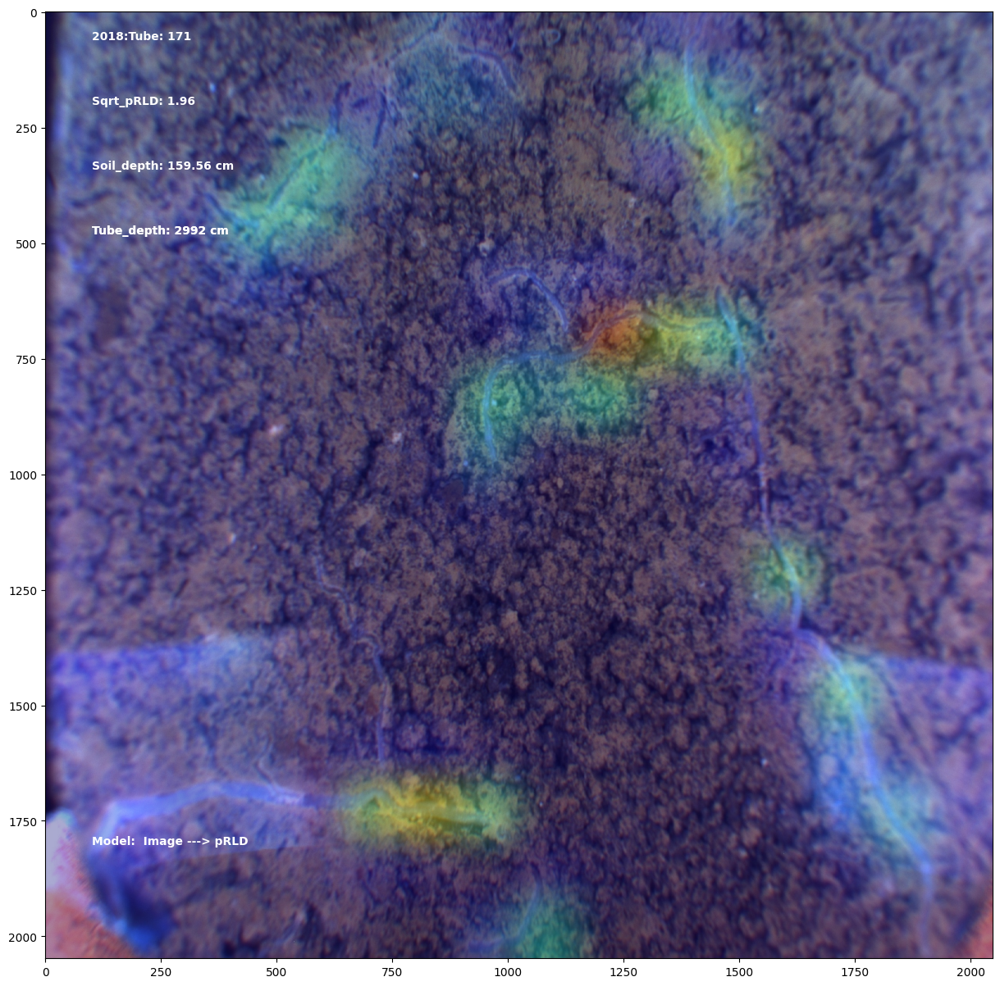

In [83]:

plt.figure(figsize=(15, 15))  # Adjust the width and height as needed
plt.imshow(superimposed_img)
plt.text(100, 480, text_label3, color='white', fontsize=10, fontweight='bold')
plt.text(100, 60, text_label, color='white', fontsize=10, fontweight='bold')
plt.text(100, 200, text_label1, color='white', fontsize=10, fontweight='bold')
plt.text(100, 340, text_label2, color='white', fontsize=10, fontweight='bold')
plt.text(100, 480, text_label3, color='white', fontsize=10, fontweight='bold')
plt.text(100, 1800, text_model, color='white', fontsize=10, fontweight='bold')



In [23]:
superimposed_img = keras.utils.array_to_img(img_array_display)

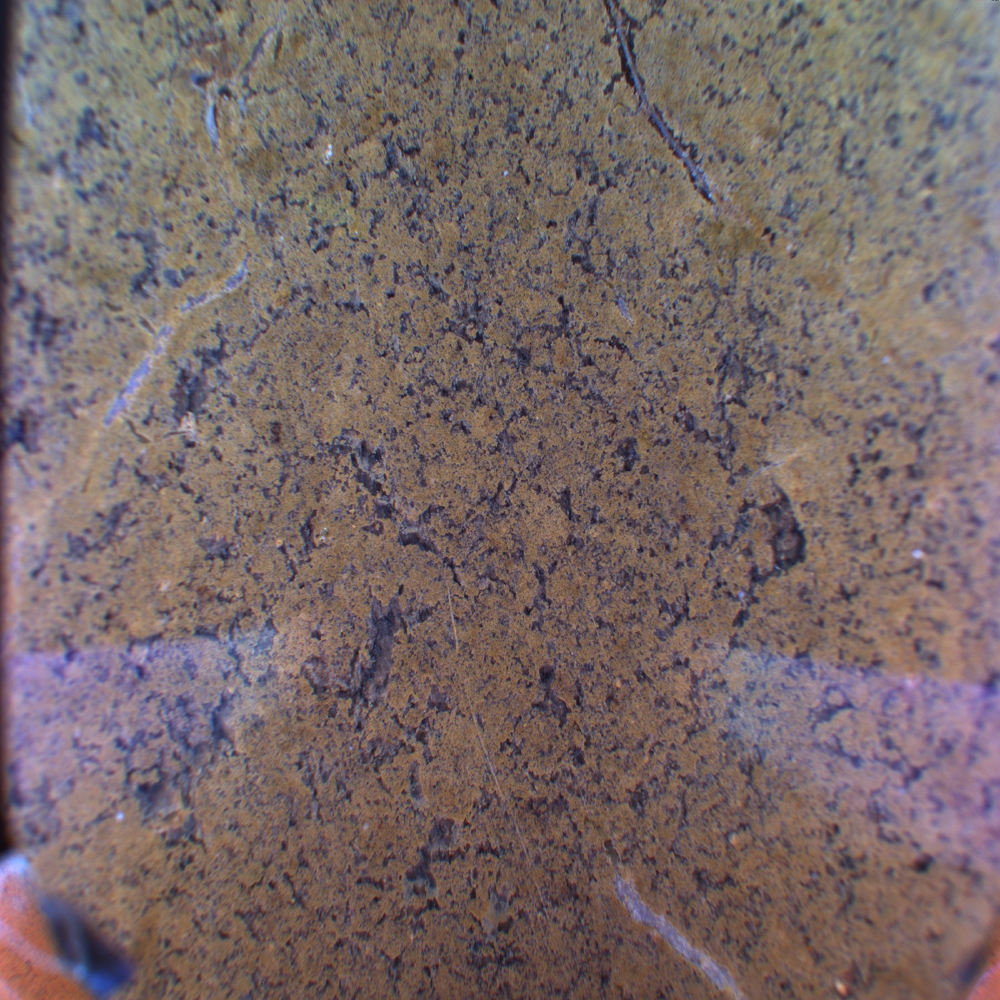

In [24]:
superimposed_img

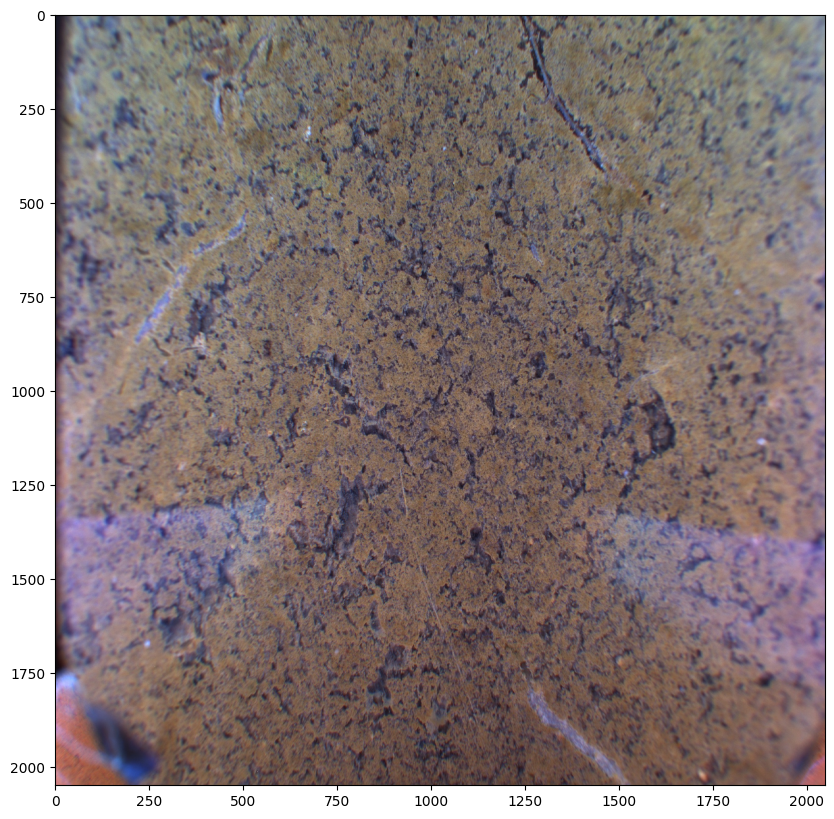

In [29]:
plt.figure(figsize=(10, 10))  # Adjust the width and height as needed

plt.imshow(img_array_display.astype('uint8'))